<a href="https://colab.research.google.com/github/glaucio1973/mvp/blob/master/MVP_SPRINT_3_Engenharia_de_Dados.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MVP - Sprint Engenharia de Dados

## Profs. Victor Almeida e Silvio Alonso

### Aluno: Gláucio Canha



# 1 - Descrição do Problema.

  Neste MVP de Engenharia de Dados decidi a trabalhar com dados de alunos do Ensino Médio de uma escola particular do Rio de Janeiro, onde anonimizei os dados para que não identificassem o aluno. Os dados contém desde 2019.
  

# 2 - Objetivo
O Objetivo deste estudo é traçar um estudo das notas pelos alunos ao longo dos anos analisando a progressão do estudo, olhando pelo viés da pontuação alcançada. Responderemos as seguintes questões:


1 - Gerar alunos com a média das notas normatizadas por ano;

2 - Alunos ranqueados por média das notas de todas as disciplinas;

3 - Dividindo as disciplinas por áreas de conhecimento e faremos uma visualização das médias por área;

4 - Média do aluno por área de conhecimento e por ano;

5 - Ranqueamento por área de conhecimento;

6 - Ranqueamento de alunos por área de conhecimento;


#3 - Coleta

Como os dados são da Instituição a qual trabalho, serão coletados através de uma consulta ao banco de dados em cima do modelo entidade relacionamento demonstrado abaixo. Na consulta fiz a anonimização de dados e foi necessário a normatização dos dados para uma análise mais real. No banco de dados tinhamos três avaliações AV1 (5), AV2 (5) E AV3 (10), Sendo que AV2 era uma nota data através de um trabalho ou por comportamento, fazendo com que tivéssemos uma variação para cima das medias. Com isso utilizei somente AV1 e AV3, normatizando a AV1 multiplicando por 2 para termos a equivalencia para AV3.


##3.1 -  Modelagem de dados

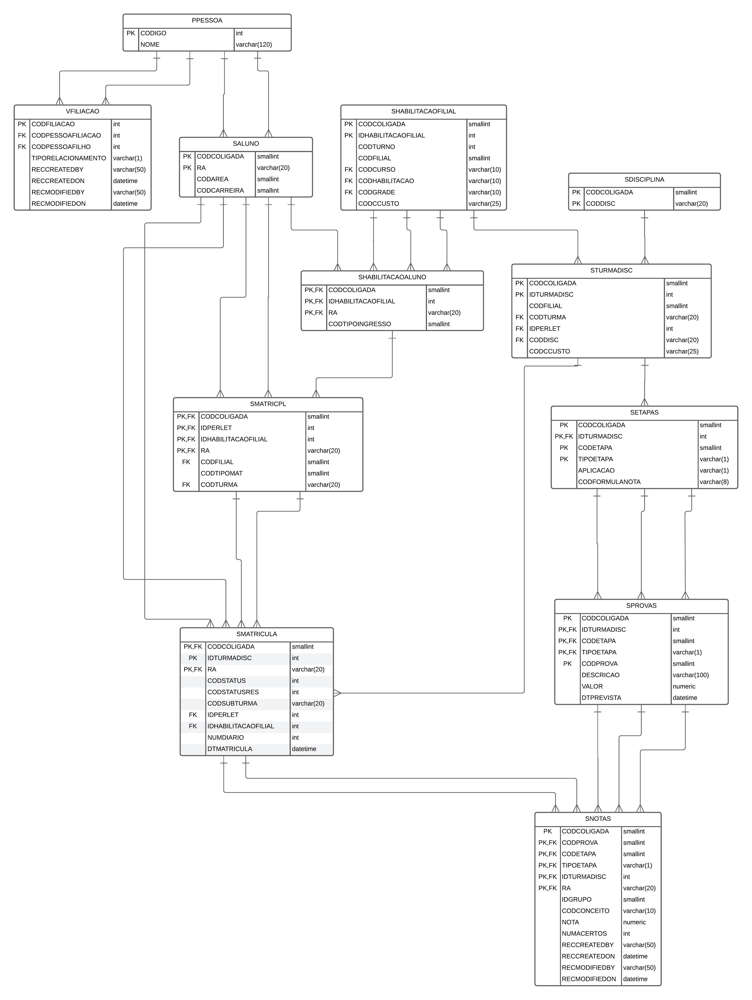

Através do modelo entidade relacionamento foi montado um modelo dimensional.


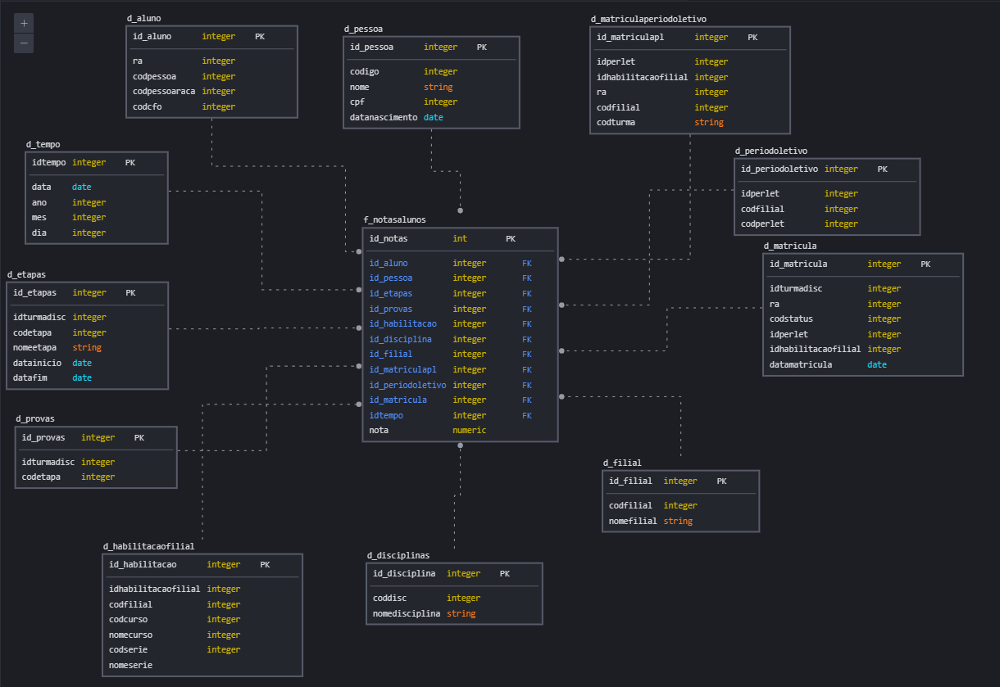

 Nesse processo vou gerar uma flat table através do arquivo de dados CSV com todas as informações necessárias para responder as perguntas do objetvo do MVP. Criei uma segunda tabela somente com o RA dos alunos de 2023, objeto do estudo. Para tal segui os passos printados abaixo:



###3.1.1 - Construi uma sql no meu banco de dados relacional para  extração das informações e gerando o arquivo nota.csv.



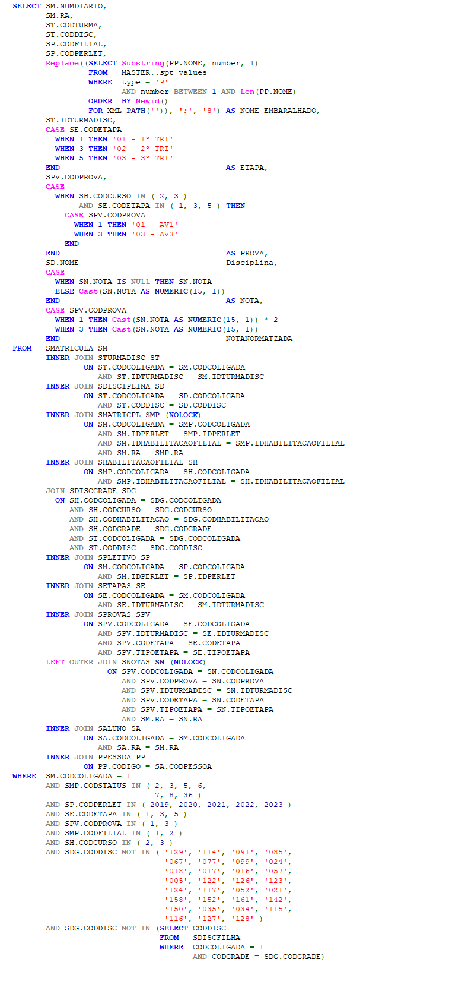





###3.1.2 - Carreguei esse arquivo para https://liessin.com.br/mvp/nota.csv




###3.1.3 - Importei ele através so SSH do console da Google Cloud para o HDFS e verifiquei a quantidade de linhas do arquivo

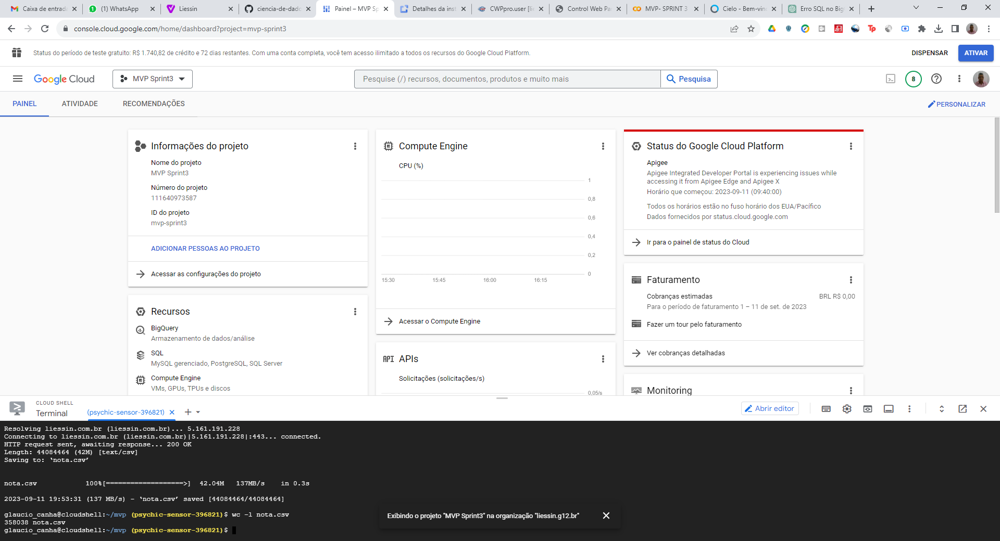

###3.1.4 - Criação do Bucket e copia do csv para dentro do mesmo

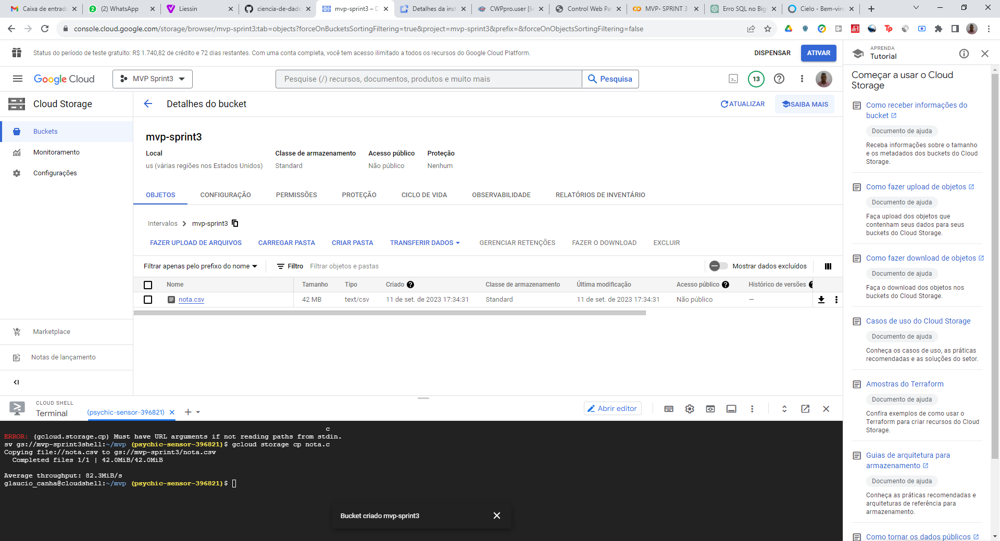

###3.1.5 - Criação do dataset

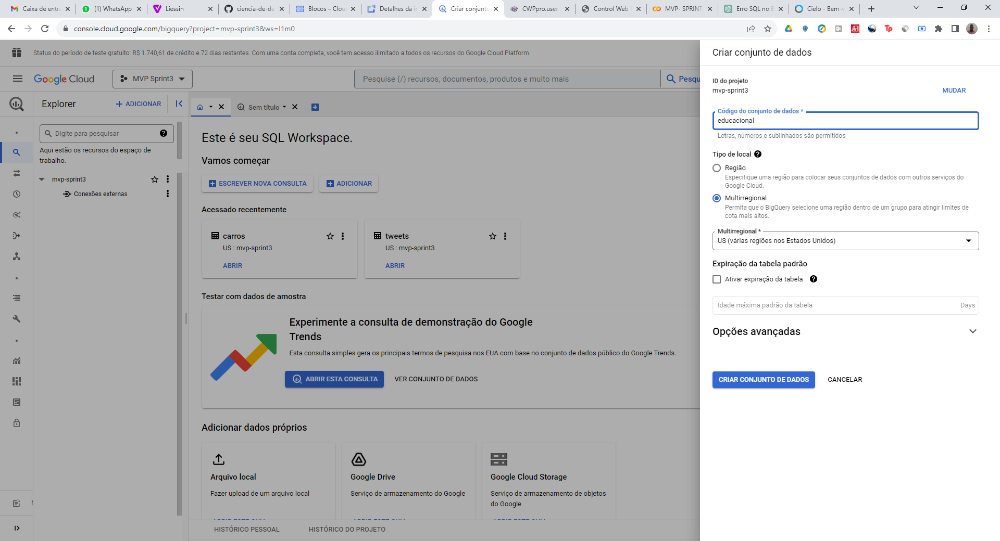

##3.2 - Catálogo de Dados

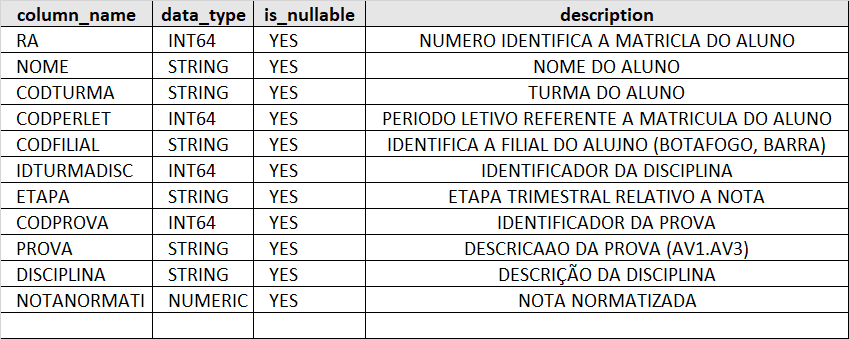

Após a criação do dataset na ferramenta do BigQuery utilizamos o Google DataPrep como a ferramenta de ETL para importarmos os dados, Segue print dad Modelagem ETL e os passos que se seguem:



#4 - Modelo ETL utilizado.

Utilizei a ferramenta DataPrep para fazer todo o processamento ETL

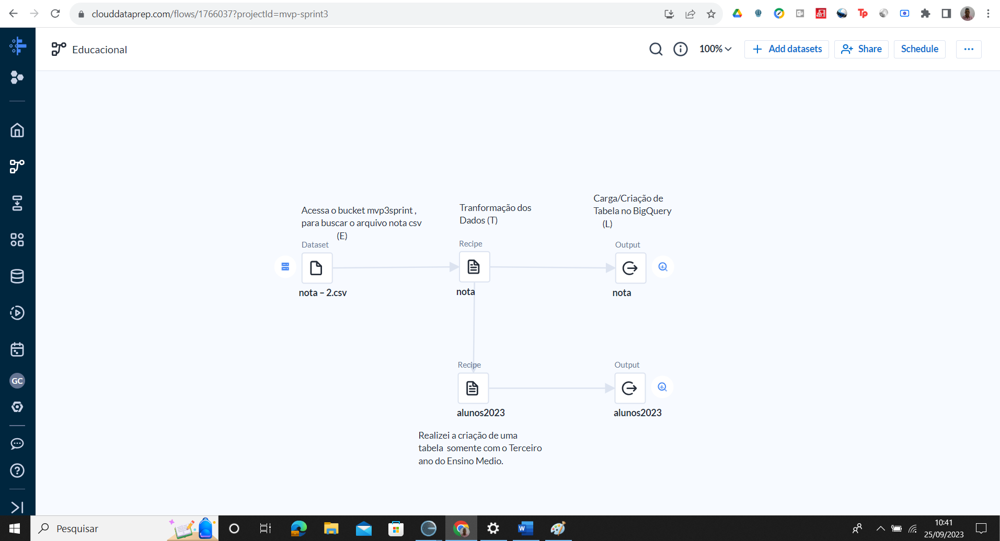

##4.1 Processos Extração do dado.
Na ferramenta do Dataprep busquei o arquivo CSV no bucket mvp-sprint3


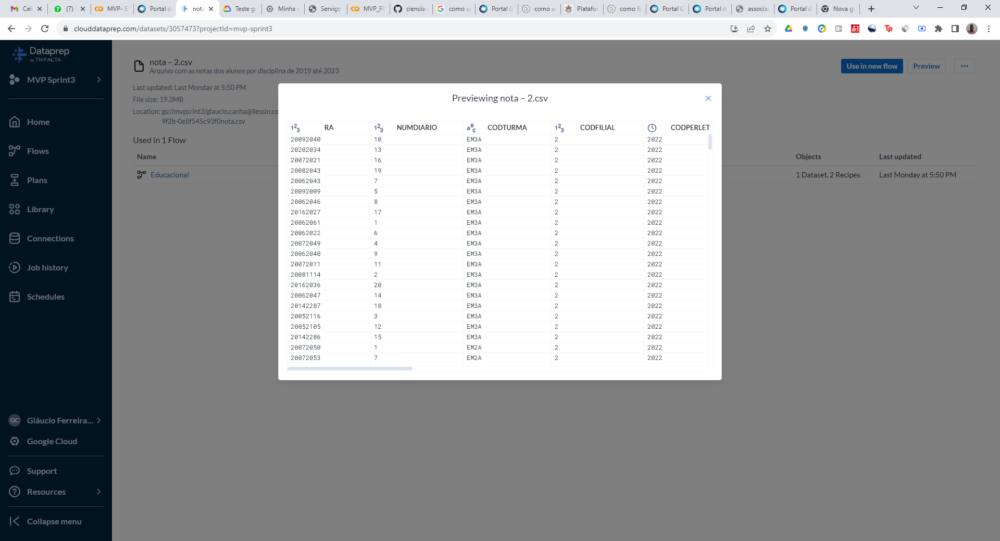

##4.2 - Processo de Transformação do Dados
Nesse processo fizemos algumas transformações como excluimos a coluna de NUMDIARIO, não necessária no nosso processo, fizemos uma transformação de tipo do dados de string para int dos campos CODPERLET, CODDISC, IDTURMADISC,CODETAPA,e CODPROVA, de string para decimal os campos NOTA e NOTANORMATIZADA e por fim fizemos um replace no campo de Filial altrando de numero para o nome da filial.


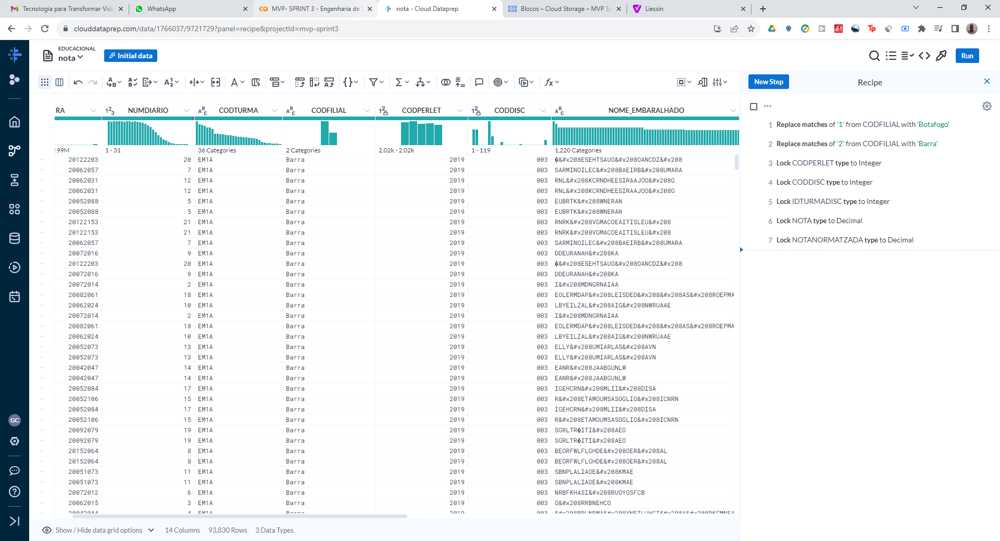


A segunda tabela criada foi para ter somente os alunos do terceiro ano Ensino Médio para fazermos uma comparação somente com esses alunos ao longo dos anos que estudaram no colégio.

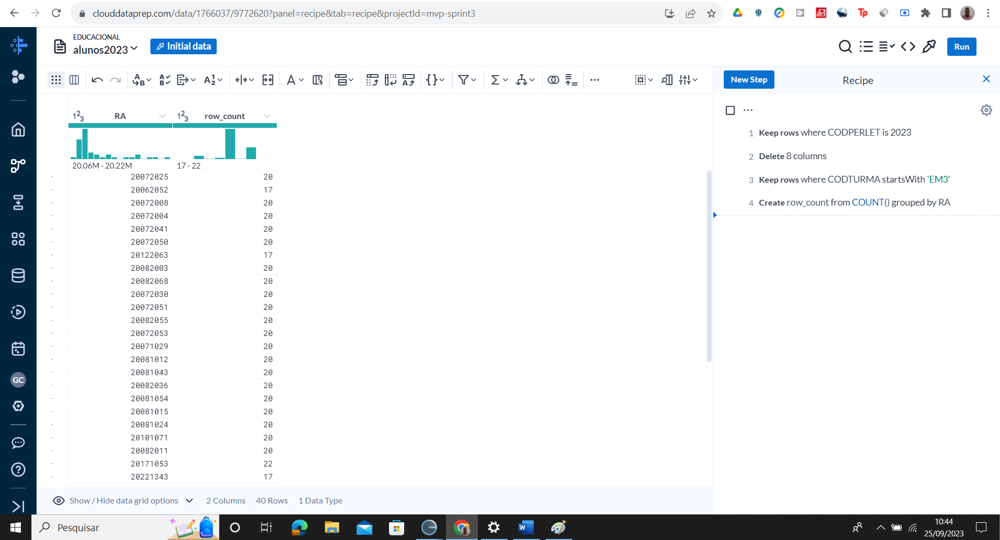

##4.3 - Processo de carga no BigQuery

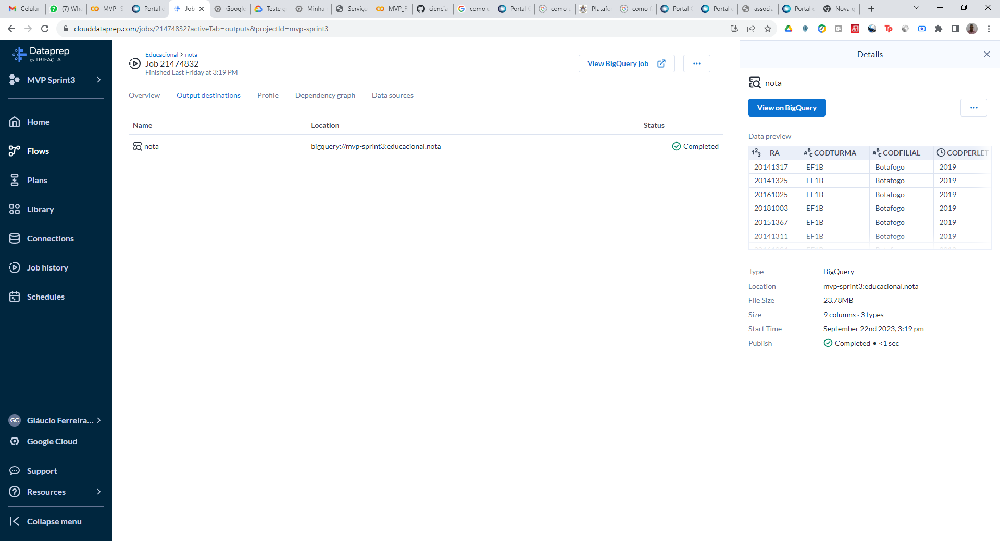

##4.4 - Relatório final do processo de ETL

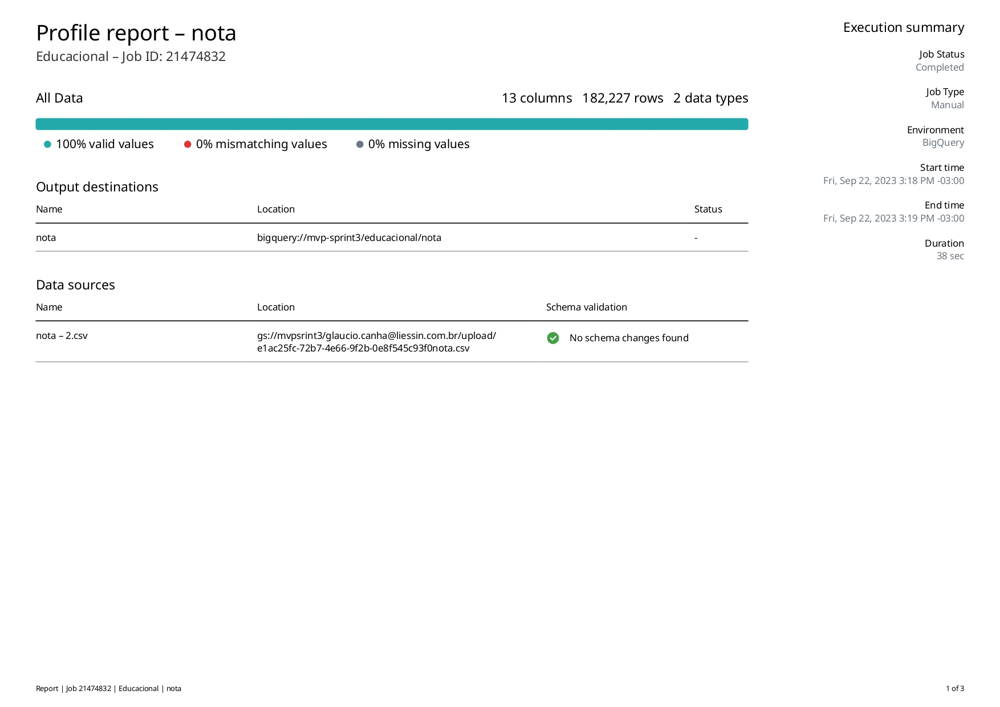

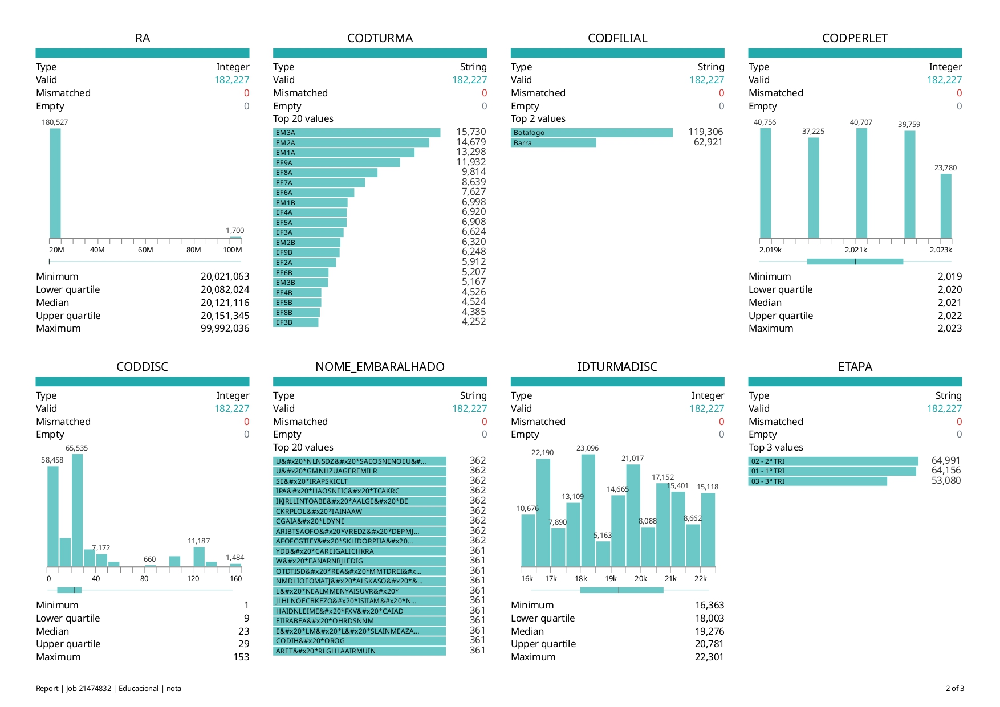

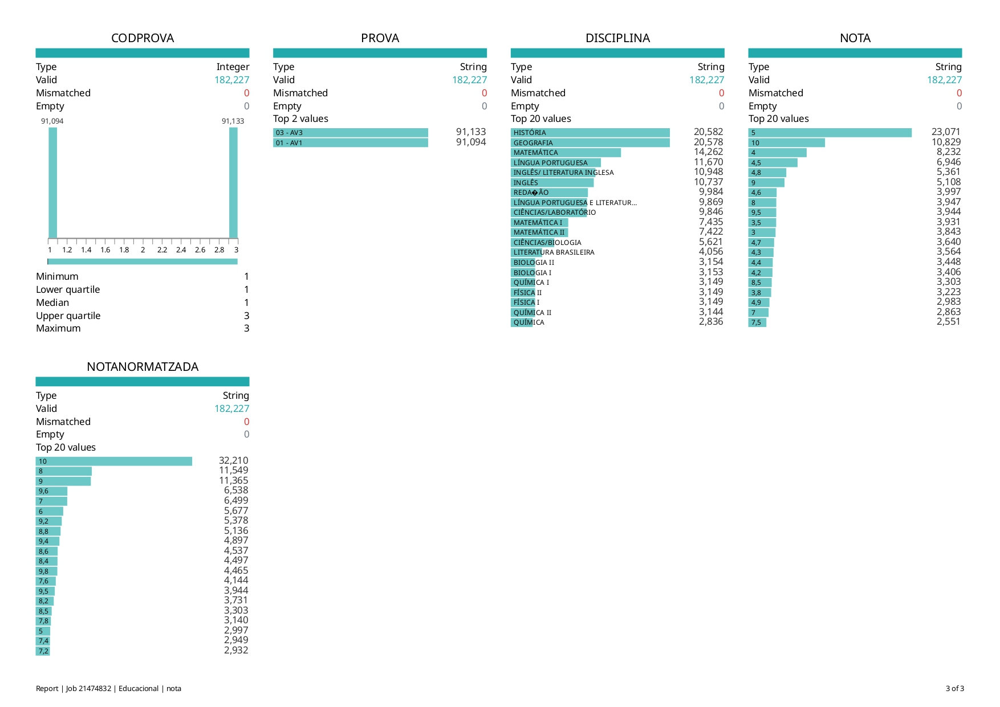

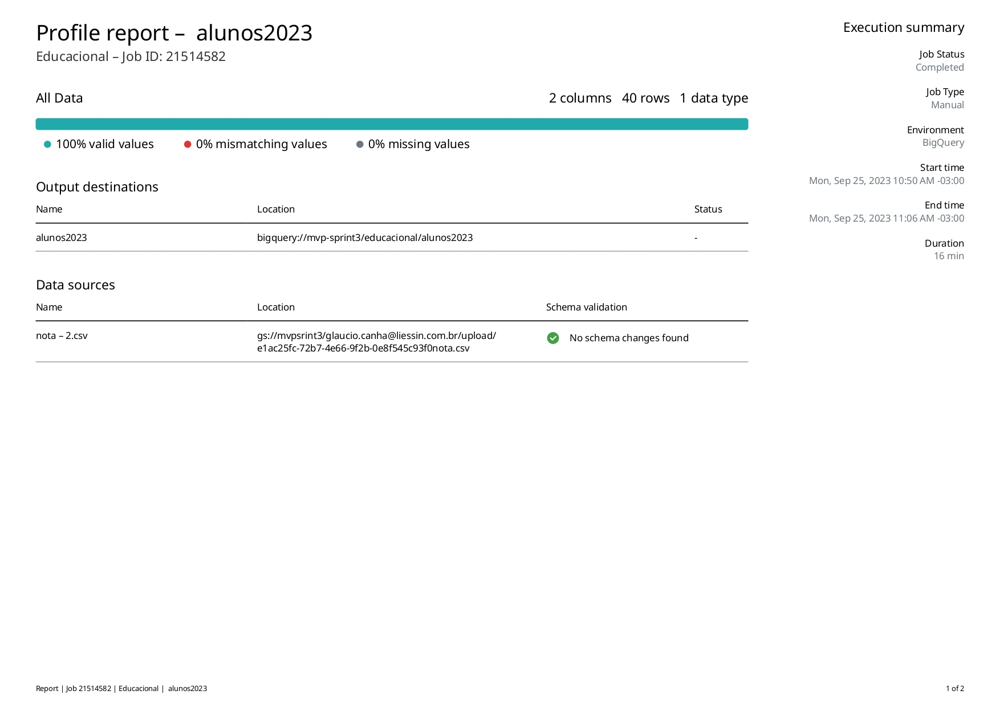

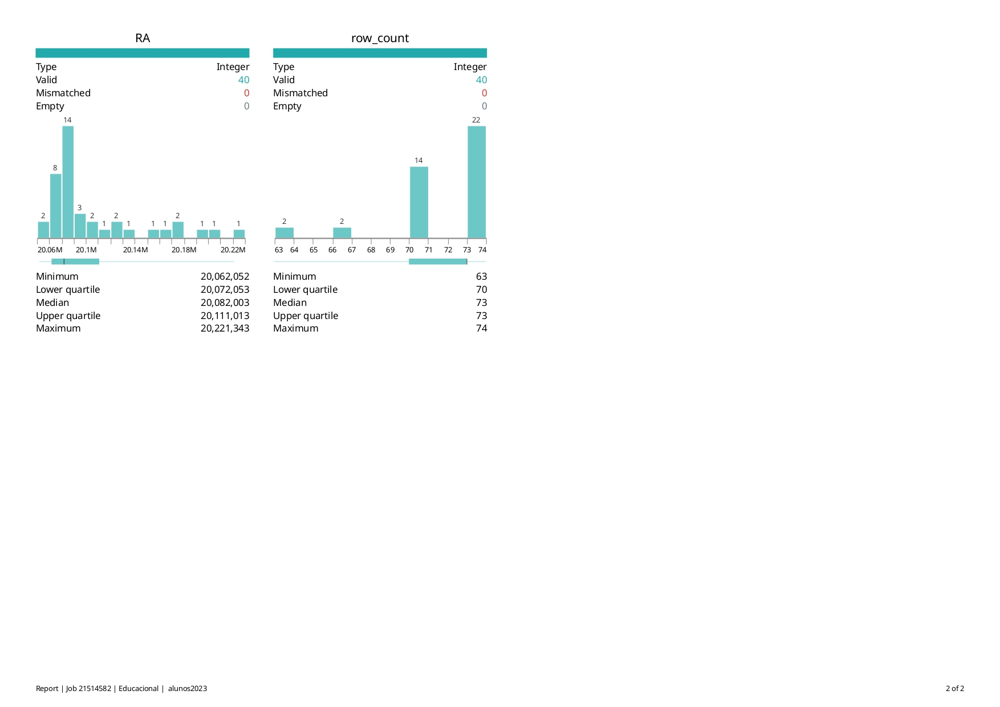

Após a tranformação configuramos a a carga no bigquery gerando duas tabelas nota e alunos2023 seguindo o modelo ETL printado acima e conforme evidências no arquivo que esta no mesmo diretorio do projeto no github.

#5 - Preparação e análise dos dados


Preparação e análise de dados
Após a importação fiz um  uma junção das tabelas nota e alunos2023 através de uma sql no bigquery.




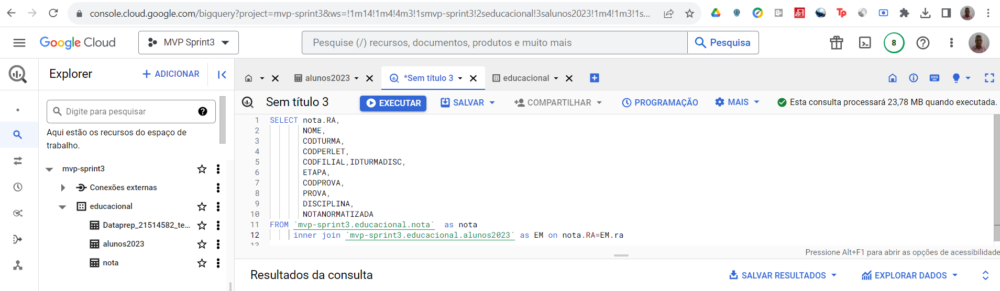

Que gerou o gráfico de execução abaixo

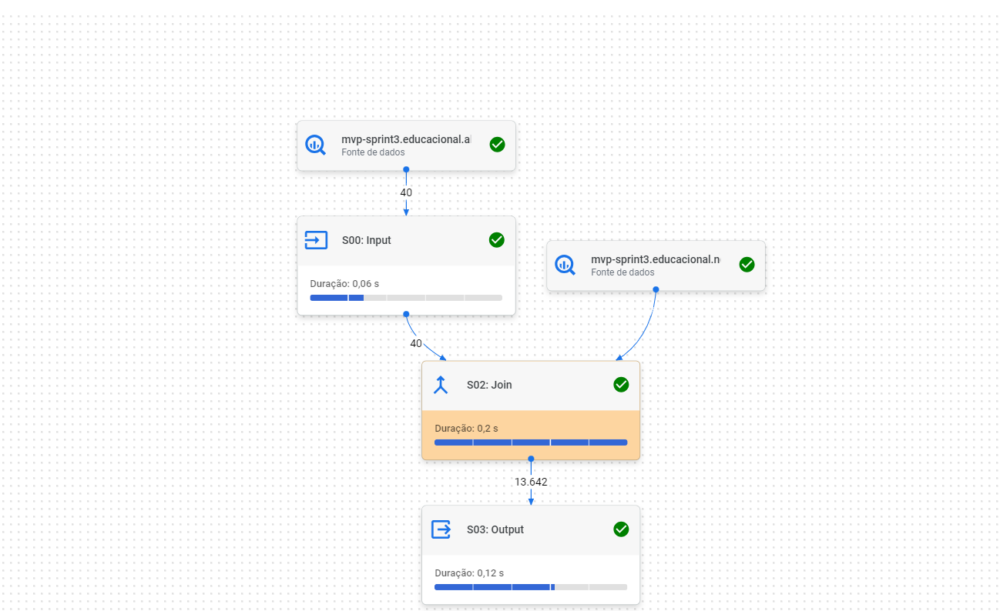

Após gerado esse resultado carreguei para um dataframe no python, fiz uma pequena análise exploratória e começei a responder algumas perguntas do objetivo do projeto.

In [15]:
# Carregando os dados da consulta acima em um dataframe
import pandas as pd
from google.colab import drive
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
from tabulate import tabulate
from google.colab import auth
from google.cloud import bigquery
from google.colab import data_table
import warnings
warnings.filterwarnings("ignore")


project = 'mvp-sprint3' # Project ID inserted based on the query results selected to explore
location = 'US' # Location inserted based on the query results selected to explore
client = bigquery.Client(project=project, location=location)
data_table.enable_dataframe_formatter()
auth.authenticate_user()

In [2]:

# Crie um cliente BigQuery
client = bigquery.Client()

# Sua consulta SQL
sql_query = """
SELECT nota.RA,
       NOME,
       CODTURMA,
       CODPERLET,
       CODFILIAL,IDTURMADISC,
       ETAPA,
       CODPROVA,
       PROVA,
       DISCIPLINA,
       NOTANORMATIZADA
FROM `mvp-sprint3.educacional.nota`  as nota
     inner join `mvp-sprint3.educacional.alunos2023` as EM on nota.RA=EM.ra
"""

# Execute a consulta
client = bigquery.Client(project='mvp-sprint3')
query_job = client.query(sql_query)

# Obtenha os resultados -Criando o DataFrame com a query rodada no BigQuery
results = query_job.to_dataframe()



##5.1 Análise exploratória

In [9]:
# A execução deste código lerá os resultados da query do BigQuery

results

,RA,NOME,CODTURMA,CODPERLET,CODFILIAL,IDTURMADISC,ETAPA,CODPROVA,PROVA,DISCIPLINA,NOTANORMATIZADA
0,20082055,OTDTISD&#x20*REA&#x20*MMTDREI&#x20*ENFLI&#x20*...,EM1A,2021,Barra,19200,01 - 1º TRI,1,01 - AV1,FÍSICA I,5.000000000
1,20082036,NMDLIOEOMATJ&#x20*ALSKASO&#x20*&#x20*,EM1A,2021,Barra,19200,01 - 1º TRI,1,01 - AV1,FÍSICA I,4.500000000
2,20072053,CODIH&#x20*OROG,EM1A,2021,Barra,19200,01 - 1º TRI,1,01 - AV1,FÍSICA I,4.300000000
3,20072030,L&#x20*NEALMMENYAISUVR&#x20*,EM1A,2021,Barra,19200,03 - 3º TRI,1,01 - AV1,FÍSICA I,4.500000000
4,20082068,JLHLNOECBKEZO&#x20*ISIIAM&#x20*NTNBÚ,EM1A,2021,Barra,19200,02 - 2º TRI,1,01 - AV1,FÍSICA I,5.000000000
...,...,...,...,...,...,...,...,...,...,...,...
13637,20081054,S&#x20*BAGGUNRRO&#x20*EAELLIPAT,EM3A,2023,Botafogo,22015,01 - 1º TRI,3,03 - AV3,MATEMÁTICA I,4.600000000
13638,20082011,IJIASHTCOCMIITAAERRH&#x20*ROZ&#x20*CLLK&#x20*E...,EM3A,2023,Botafogo,22015,01 - 1º TRI,3,03 - AV3,MATEMÁTICA I,6.000000000
13639,20071029,UENEVNBRHTO&#x20*EGR,EM3A,2023,Botafogo,22015,02 - 2º TRI,3,03 - AV3,MATEMÁTICA I,6.900000000
13640,20081015,LEMEARSDSVNI&#x20*ATYSKOV,EM3A,2023,Botafogo,22015,02 - 2º TRI,3,03 - AV3,MATEMÁTICA I,6.500000000


In [10]:
#Faremos uma exploção rapida dos dados.
print(results.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13642 entries, 0 to 13641
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   RA               13642 non-null  Int64 
 1   NOME             13642 non-null  object
 2   CODTURMA         13642 non-null  object
 3   CODPERLET        13642 non-null  Int64 
 4   CODFILIAL        13642 non-null  object
 5   IDTURMADISC      13642 non-null  Int64 
 6   ETAPA            13642 non-null  object
 7   CODPROVA         13642 non-null  Int64 
 8   PROVA            13642 non-null  object
 9   DISCIPLINA       13642 non-null  object
 10  NOTANORMATIZADA  13642 non-null  object
dtypes: Int64(4), object(7)
memory usage: 1.2+ MB
None


In [11]:
# Fazendo uma visualização dos dados.
display(results)

,RA,NOME,CODTURMA,CODPERLET,CODFILIAL,IDTURMADISC,ETAPA,CODPROVA,PROVA,DISCIPLINA,NOTANORMATIZADA
0,20082055,OTDTISD&#x20*REA&#x20*MMTDREI&#x20*ENFLI&#x20*...,EM1A,2021,Barra,19200,01 - 1º TRI,1,01 - AV1,FÍSICA I,5.000000000
1,20082036,NMDLIOEOMATJ&#x20*ALSKASO&#x20*&#x20*,EM1A,2021,Barra,19200,01 - 1º TRI,1,01 - AV1,FÍSICA I,4.500000000
2,20072053,CODIH&#x20*OROG,EM1A,2021,Barra,19200,01 - 1º TRI,1,01 - AV1,FÍSICA I,4.300000000
3,20072030,L&#x20*NEALMMENYAISUVR&#x20*,EM1A,2021,Barra,19200,03 - 3º TRI,1,01 - AV1,FÍSICA I,4.500000000
4,20082068,JLHLNOECBKEZO&#x20*ISIIAM&#x20*NTNBÚ,EM1A,2021,Barra,19200,02 - 2º TRI,1,01 - AV1,FÍSICA I,5.000000000
...,...,...,...,...,...,...,...,...,...,...,...
13637,20081054,S&#x20*BAGGUNRRO&#x20*EAELLIPAT,EM3A,2023,Botafogo,22015,01 - 1º TRI,3,03 - AV3,MATEMÁTICA I,4.600000000
13638,20082011,IJIASHTCOCMIITAAERRH&#x20*ROZ&#x20*CLLK&#x20*E...,EM3A,2023,Botafogo,22015,01 - 1º TRI,3,03 - AV3,MATEMÁTICA I,6.000000000
13639,20071029,UENEVNBRHTO&#x20*EGR,EM3A,2023,Botafogo,22015,02 - 2º TRI,3,03 - AV3,MATEMÁTICA I,6.900000000
13640,20081015,LEMEARSDSVNI&#x20*ATYSKOV,EM3A,2023,Botafogo,22015,02 - 2º TRI,3,03 - AV3,MATEMÁTICA I,6.500000000


In [12]:
notas = results['NOTANORMATIZADA']
notas.describe()

count           13642
unique             99
top       5.000000000
freq             1394
Name: NOTANORMATIZADA, dtype: object

In [7]:
#Tamanho do Dataframe
results.shape

(13642, 11)

Verificando a existência de outliers

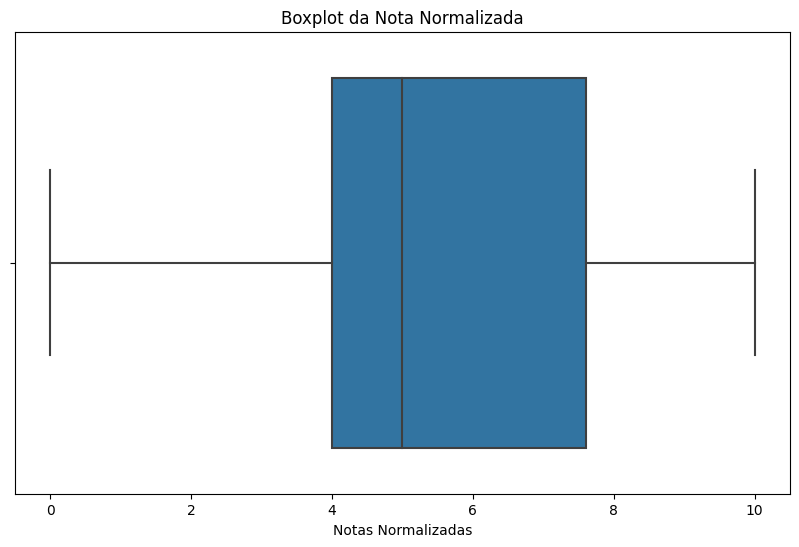

In [16]:
#carregamos os dados do resultado da query para df
df=results
# Converta a coluna NOTANORMATIZADA para float
df['NOTANORMATIZADA'] = df['NOTANORMATIZADA'].astype(float)

# Crie um boxplot para a coluna NOTANORMATIZADA
plt.figure(figsize=(10, 6))
sns.boxplot(x='NOTANORMATIZADA', data=df)
plt.xlabel('Notas Normalizadas')
plt.title('Boxplot da Nota Normalizada')
plt.show()

#6 - Vamos responder as perguntas sobre o Objetivo do projeto



##6.1 - Gerar alunos com a média das notas normatizadas por ano.

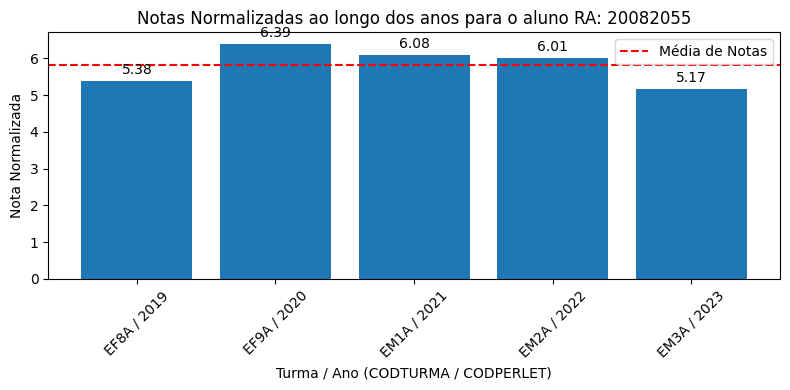

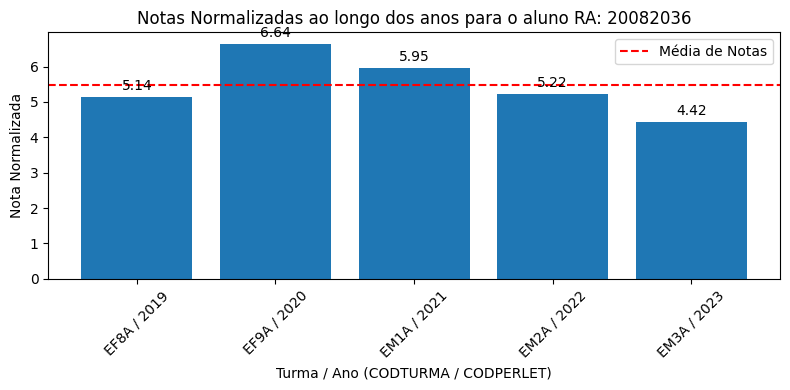

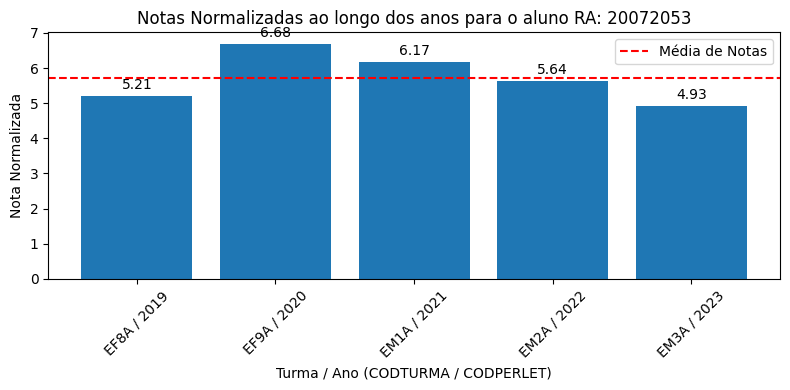

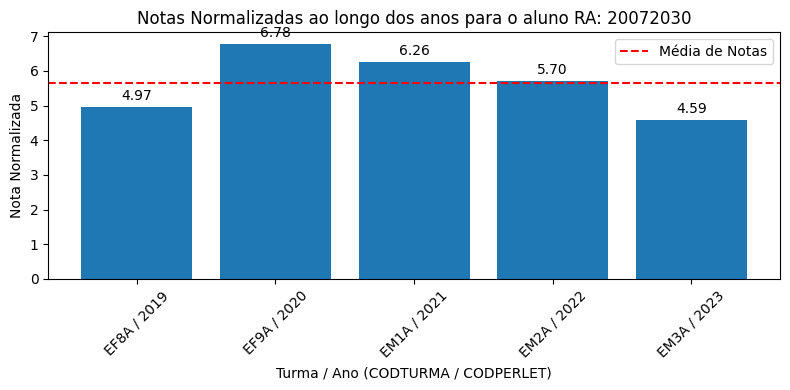

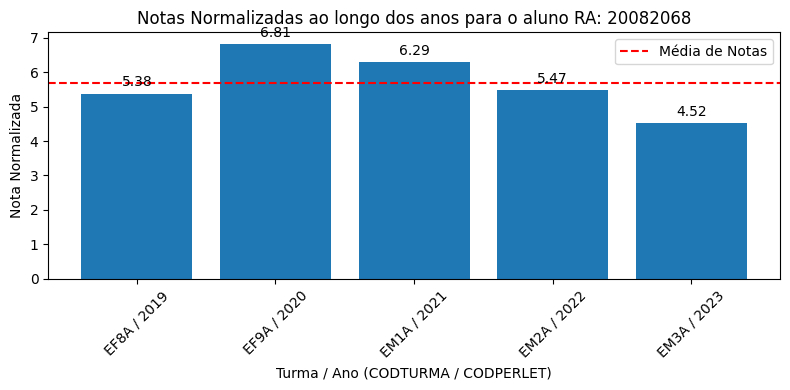

...

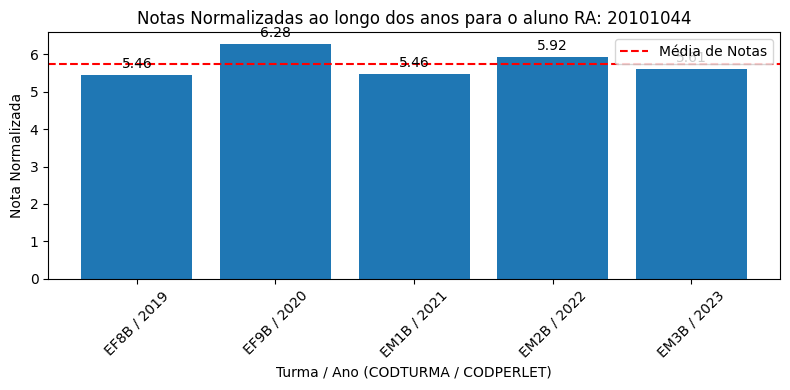

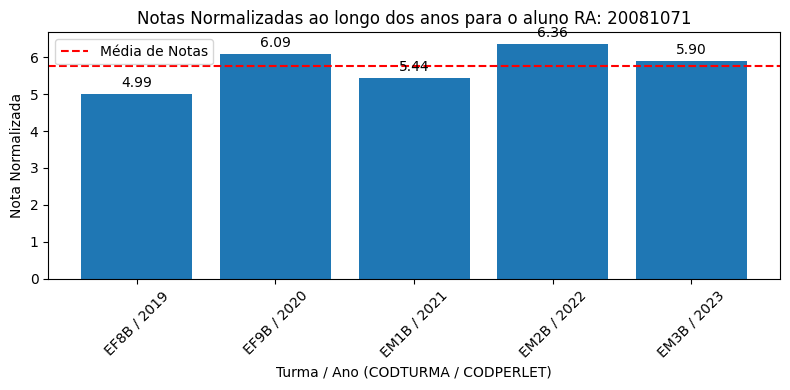

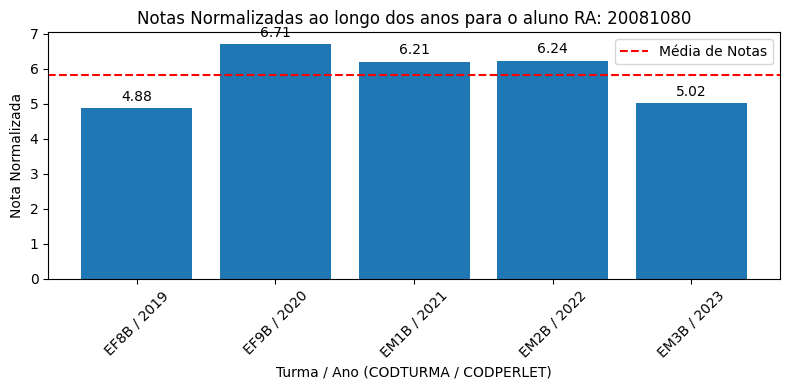

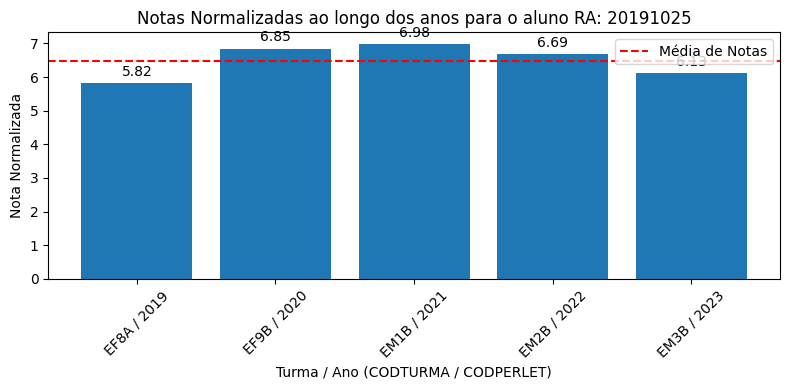

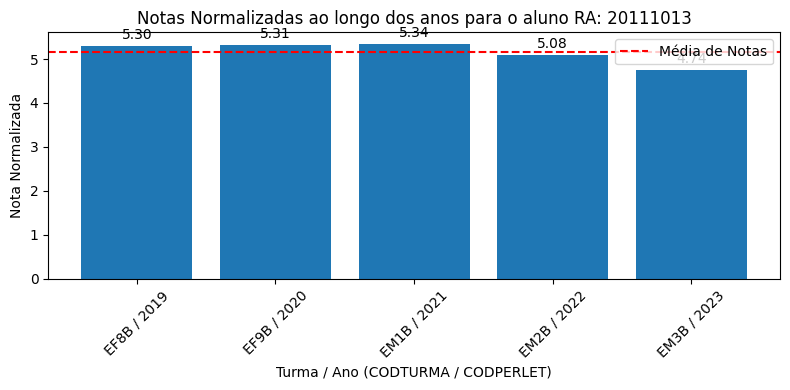

In [17]:


# Primeiro, convertemos as colunas "CODTURMA" e "CODPERLET" em strings
df['CODTURMA'] = df['CODTURMA'].astype(str)
df['CODPERLET'] = df['CODPERLET'].astype(str)

# Em seguida, agrupamos os dados por "RA," "CODTURMA," e "CODPERLET," e calculamos a média das notas normalizadas
notas_por_aluno = df.groupby(['RA', 'CODTURMA', 'CODPERLET'])['NOTANORMATIZADA'].mean().reset_index()

# Agora, criaremos um gráfico de barras para cada aluno com uma linha de progressão e a nota no topo de cada barra
alunos = df['RA'].unique()

for aluno in alunos:
    dados_aluno = notas_por_aluno[notas_por_aluno['RA'] == aluno]

    # Calcular a média das notas ao longo dos anos
    media_notas = dados_aluno['NOTANORMATIZADA'].mean()

    # Criar um gráfico de barras para as notas do aluno
    plt.figure(figsize=(8, 4))
    x_labels = dados_aluno['CODTURMA'] + " / " + dados_aluno['CODPERLET']
    ax = plt.bar(x_labels, dados_aluno['NOTANORMATIZADA'])

    # Adicionar a linha de progressão nas notas normalizadas
    plt.axhline(y=media_notas, color='r', linestyle='--', label='Média de Notas')

    # Adicionar as notas no topo de cada barra
    for rect in ax:
        height = rect.get_height()
        plt.annotate(f'{height:.2f}', xy=(rect.get_x() + rect.get_width() / 2, height), xytext=(0, 3),
                     textcoords='offset points', ha='center', va='bottom')

    plt.xlabel('Turma / Ano (CODTURMA / CODPERLET)')
    plt.ylabel('Nota Normalizada')
    plt.title(f'Notas Normalizadas ao longo dos anos para o aluno RA: {aluno}')
    plt.xticks(rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()



##6.2 - Alunos ranqueados por média das notas de todas as disciplinas.


In [19]:


# Primeiro, convertemos as colunas "CODTURMA" e "CODPERLET" em strings
df['CODTURMA'] = df['CODTURMA'].astype(str)
df['CODPERLET'] = df['CODPERLET'].astype(str)

# Em seguida, agrupamos os dados por "RA" e "NOME" e calculamos a média das notas normalizadas
notas_por_aluno = df.groupby(['RA', 'NOME'])['NOTANORMATIZADA'].mean().reset_index()

# Classificamos os alunos com base na média das notas em ordem decrescente (do melhor para o pior)
ranking_alunos = notas_por_aluno.sort_values(by='NOTANORMATIZADA', ascending=False)

# Adicionamos uma coluna "Colocação" para representar a posição de cada aluno no ranking
ranking_alunos['Colocação'] = range(1, len(ranking_alunos) + 1)

# Selecionamos as colunas desejadas (Colocação, RA, NOME e NOTANORMATIZADA) para exibir
ranking_final = ranking_alunos[['Colocação', 'RA', 'NOME', 'NOTANORMATIZADA']]

# Renomeamos a coluna 'NOTANORMATIZADA' para 'NOTA'
ranking_final.rename(columns={'NOTANORMATIZADA': 'NOTA'}, inplace=True)

# Exibimos o ranking dos alunos em formato tabular com título
print("Ranking dos Alunos por Média da Nota Normalizada")
print(tabulate(ranking_final, headers='keys', tablefmt='pretty', showindex=False))


Ranking dos Alunos por Média da Nota Normalizada
+-----------+----------+------------------------------------------------------------+--------------------+
| Colocação |    RA    |                            NOME                            |        NOTA        |
+-----------+----------+------------------------------------------------------------+--------------------+
|     1     | 20072050 | E&#x20*LM&#x20*L&#x20*SLAINMEAZAEEEDANNU&#x20*VZDA&#x20*ES | 6.565650969529085  |
|     2     | 20191025 |                   U&#x20*GMNHZUAGEREMILR                   | 6.558287292817679  |
|     3     | 20072008 |               &#x20*NVRLEAONAAKRDD&#x20*BIR                | 6.529916897506926  |
|     4     | 20171089 |            U&#x20*NLNSDZ&#x20*SAEOSNENOEU&#x20*            | 6.322375690607735  |
|     5     | 20072051 |                   EIIRABEA&#x20*OHRDSNNM                   | 6.255124653739612  |
|     6     | 20081043 |            IIVUEGMEIP&#x20*HAGLD&#x20*RNLUSREE             | 6.2444134

##6.3 - Dividindo as disciplinas por áreas de conhecimento e faremos uma visualização das médias por área.


In [18]:
# Mapeie as disciplinas para as áreas correspondentes
area_mapping = {
  'LÍNGUA PORTUGUESA E LITERATURA':'Linguagens',
'CIÊNCIAS/LABORATÓRIO': 'Ciencias da Natureza',
'BIOLOGIA': 'Ciencias da Natureza',
'LÍNGUA PORTUGUESA' :'Linguagens',
'FÍSICA I': 'Ciencias da Natureza',
'REDAÇÃO':'Linguagens',
'MATEMÁTICA II': 'Matematica e suas tecnologias',
'MATEMÁTICA': 'Matematica e suas tecnologias',
'FÍSICA II': 'Ciencias da Natureza',
'GEOGRAFIA':'Ciencias Humanas',
'HISTÓRIA':'Ciencias Humanas',
'QUÍMICA I': 'Ciencias da Natureza',
'MATEMÁTICA I': 'Matematica e suas tecnologias',
'QUÍMICA II': 'Ciencias da Natureza',
'INGLÊS/ LITERATURA INGLESA':'Linguagens',
'QUÍMICA': 'Ciencias da Natureza',
'CIÊNCIAS/BIOLOGIA': 'Ciencias da Natureza',
'INGLÊS':'Linguagens',
'FÍSICA': 'Ciencias da Natureza',
'BIOLOGIA I': 'Ciencias da Natureza',
'BIOLOGIA II': 'Ciencias da Natureza',
'GEOGRAFIA I':'Ciencias Humanas',
'GEOGRAFIA II':'Ciencias Humanas',
'HISTÓRIA I':'Ciencias Humanas',
'HISTÓRIA II':'Ciencias Humanas',
'LITERATURA BRASILEIRA':'Linguagens',
'MATEMÁTICA III': 'Matematica e suas tecnologias',
'REDAÇÃO I':'Linguagens',
'ESPANHOL' :'Linguagens',
'PRODUÇÃO TEXTUAL':'Linguagens',
'LITERATURA INGLESA':'Linguagens',
'LINGUA PORTUGUESA':'Linguagens'

}

df['Area'] = df['DISCIPLINA'].map(area_mapping)

# Agora você pode analisar as notas por área
notas_por_area = df.groupby('Area')['NOTANORMATIZADA'].mean()

# Imprima ou faça o que quiser com as médias das notas por área
print(notas_por_area)

Area
Ciencias Humanas                 5.742038
Ciencias da Natureza             5.762287
Linguagens                       5.593443
Matematica e suas tecnologias    5.634827
Name: NOTANORMATIZADA, dtype: float64


##6.4 - Média do aluno por área de conhecimento e por ano


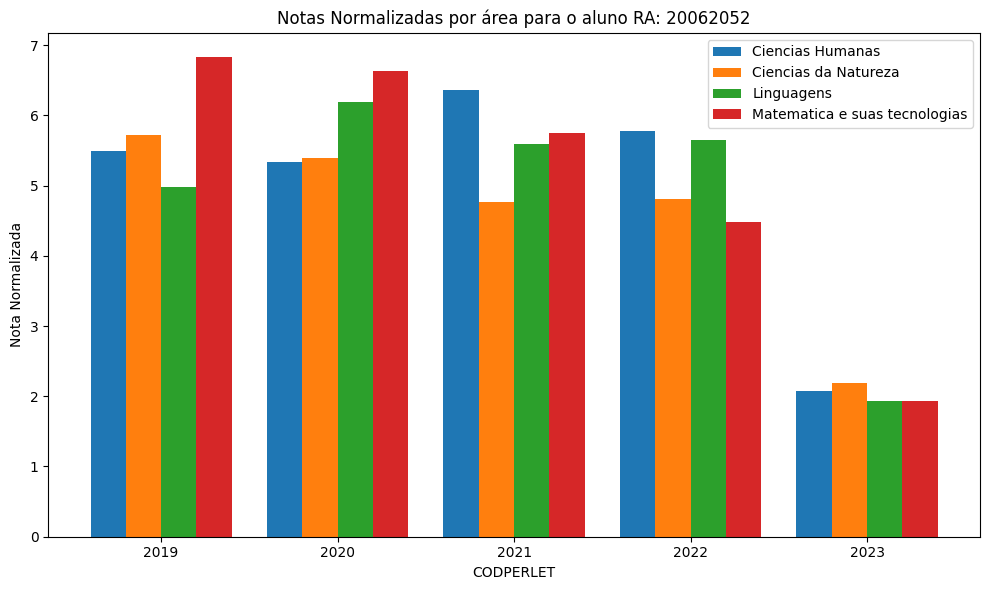

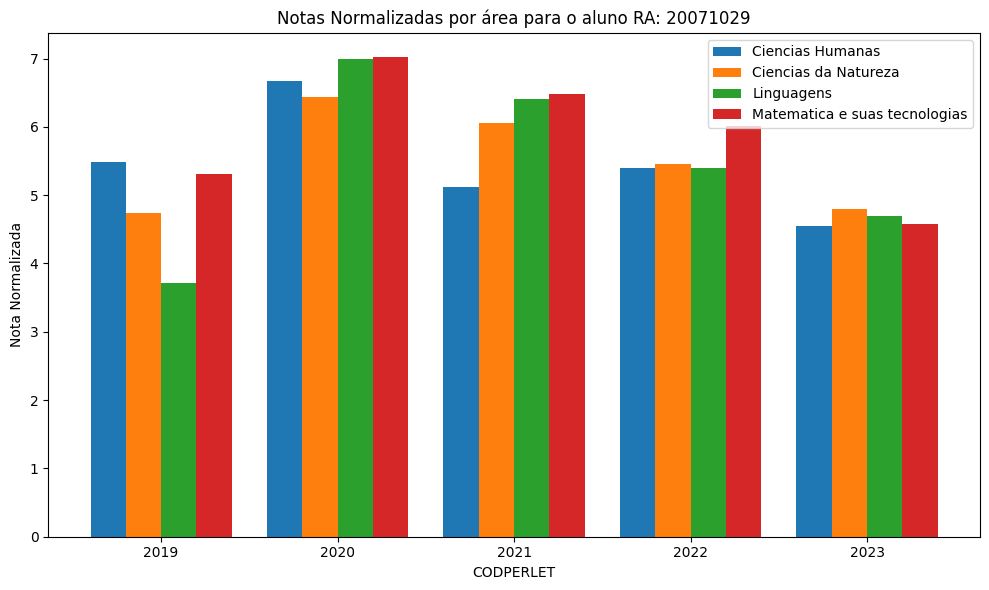

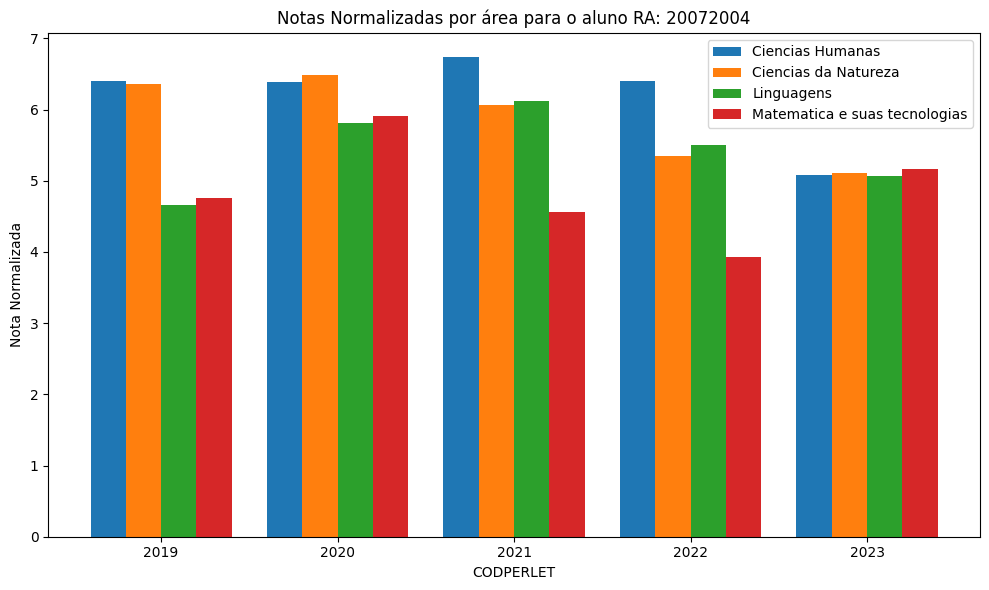

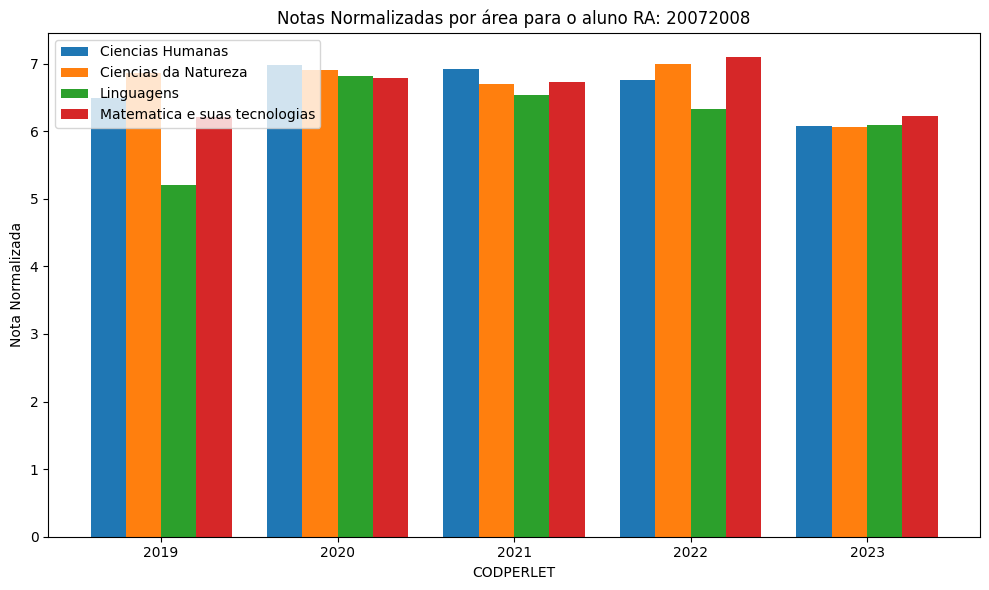

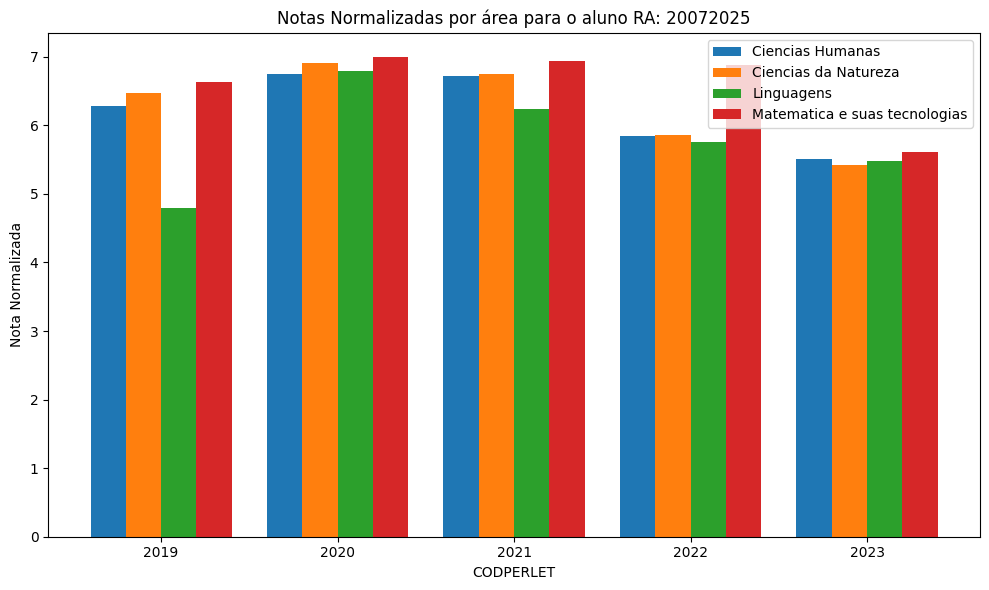

...

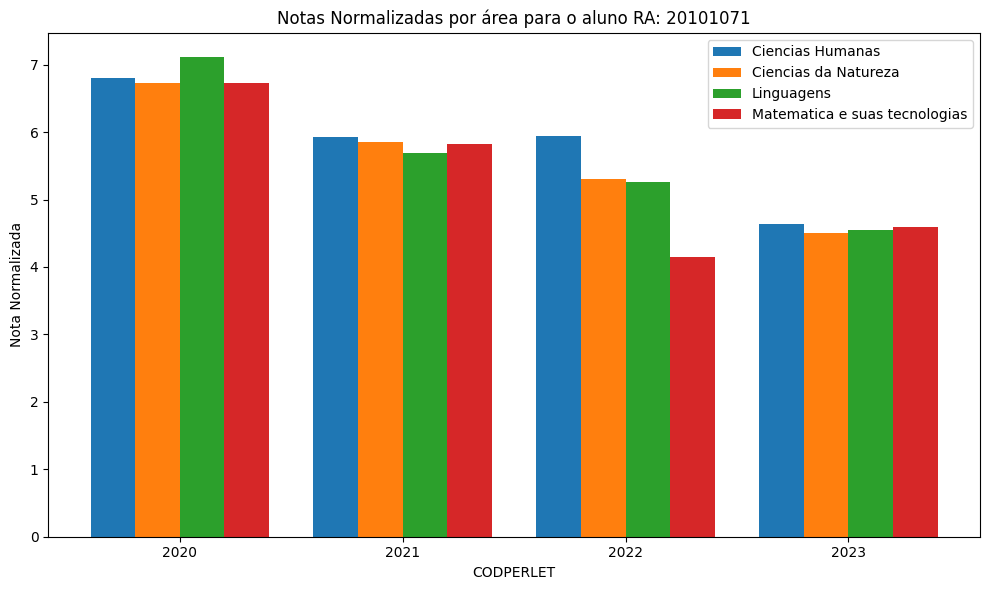

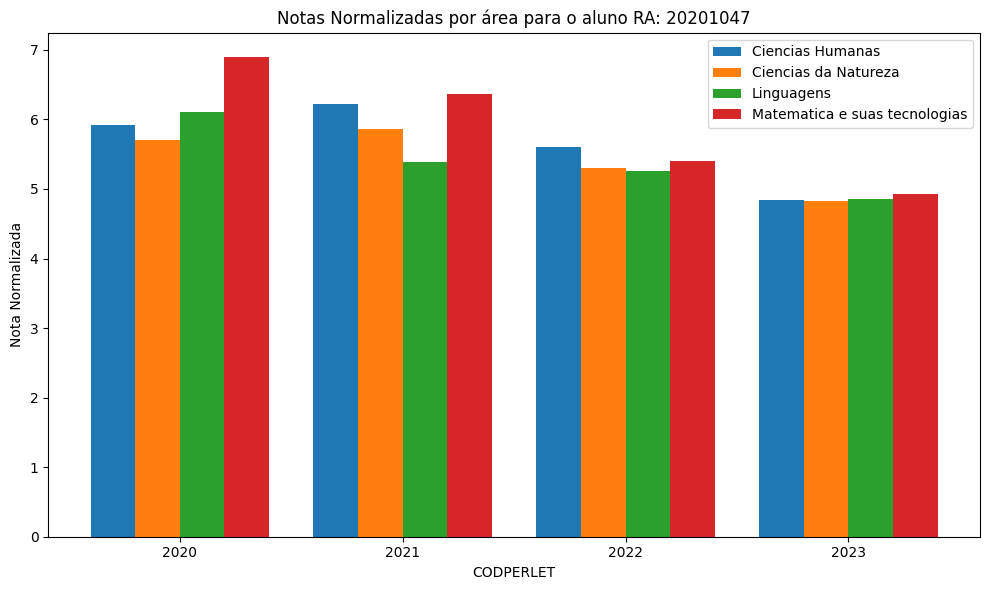

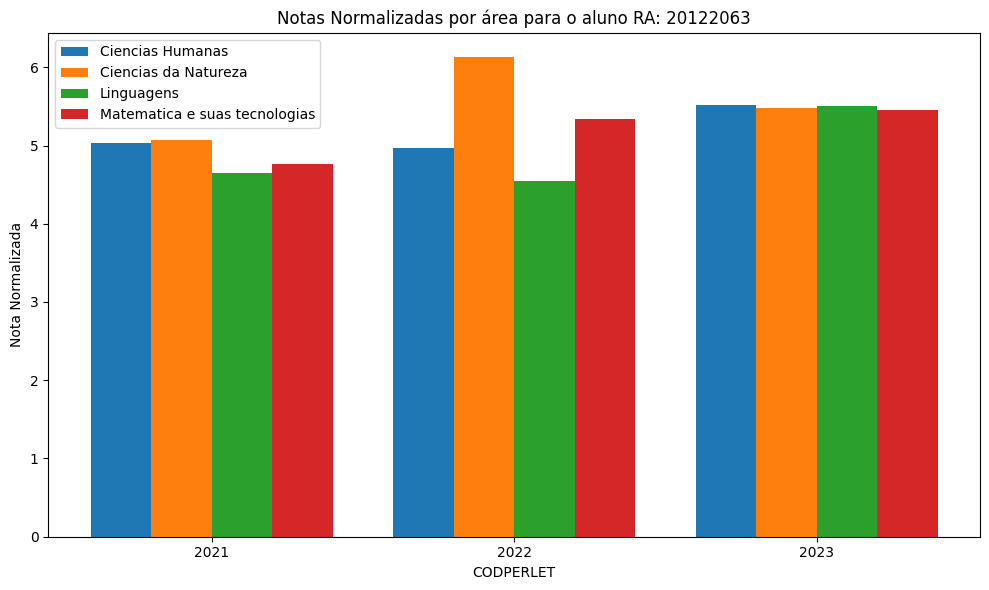

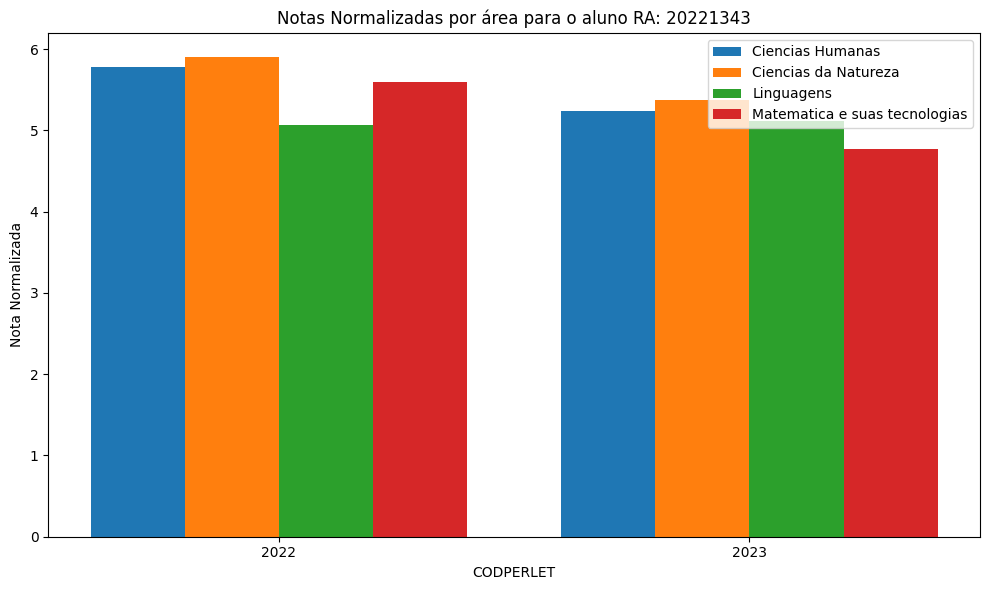

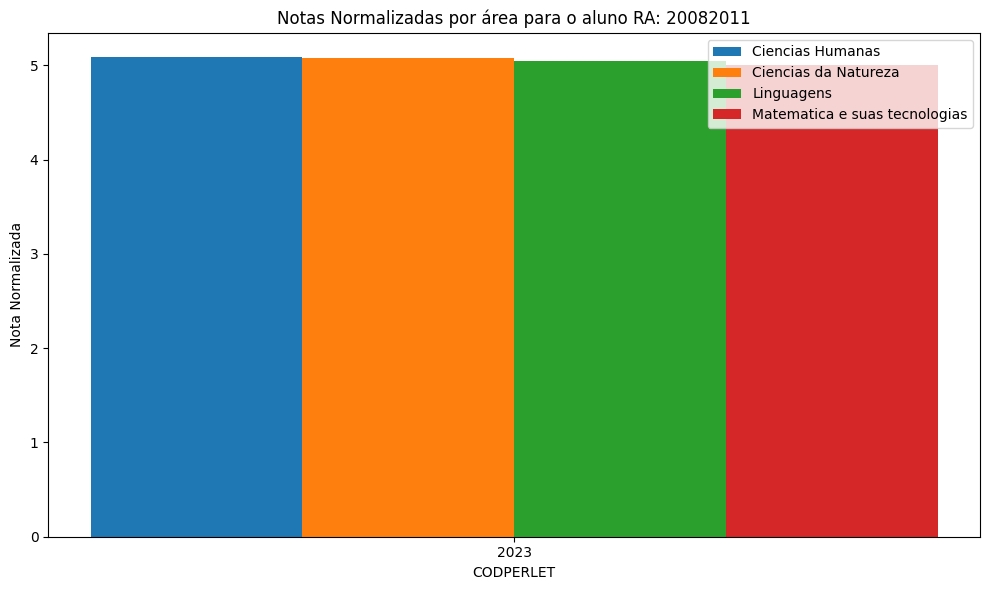

In [20]:
# Agrupe os dados por CODPERLET, RA e Area e calcule a média das notas normalizadas
notas_por_area = df.groupby(['CODPERLET', 'RA', 'Area'])['NOTANORMATIZADA'].mean().reset_index()

# Agora, criaremos um gráfico de barras para cada aluno por CODPERLET com barras para cada área
alunos = notas_por_area['RA'].unique()

for aluno in alunos:
    dados_aluno = notas_por_area[notas_por_area['RA'] == aluno]
    codperlets = dados_aluno['CODPERLET'].unique()

    # Configurações para a posição das barras
    bar_width = 0.2
    opacity = 0.8
    bar_positions = np.arange(len(codperlets))

    plt.figure(figsize=(10, 6))

    for i, area in enumerate(dados_aluno['Area'].unique()):
        dados_area = dados_aluno[dados_aluno['Area'] == area]
        plt.bar(
            x=bar_positions + i * bar_width,
            height=dados_area['NOTANORMATIZADA'],
            width=bar_width,
            label=area
        )

    # Configurações adicionais
    plt.xlabel('CODPERLET')
    plt.ylabel('Nota Normalizada')
    plt.title(f'Notas Normalizadas por área para o aluno RA: {aluno}')
    plt.xticks(bar_positions + (len(dados_aluno['Area'].unique()) - 1) * bar_width / 2, codperlets)
    plt.legend()
    plt.tight_layout()
    plt.show()

##6.5 - Ranqueamento por área de conhecimento.


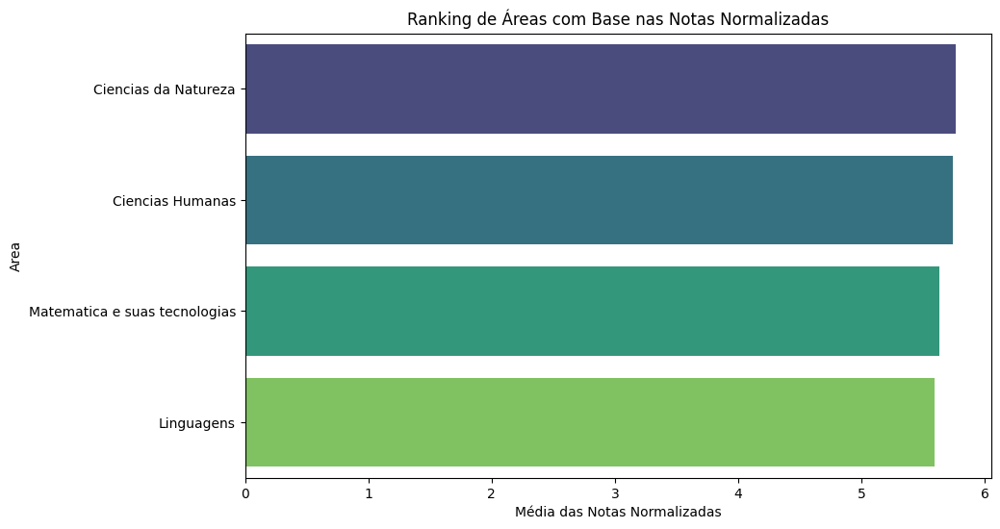

In [21]:
df['Area'] = df['DISCIPLINA'].map(area_mapping)

# Agrupe os dados por área e calcule a média das notas normalizadas
ranking_areas = df.groupby('Area')['NOTANORMATIZADA'].mean().reset_index()

# Ordene as áreas com base nas médias das notas
ranking_areas = ranking_areas.sort_values(by='NOTANORMATIZADA', ascending=False)

# Crie um gráfico de barras para visualizar o ranking
plt.figure(figsize=(10, 6))
sns.barplot(x='NOTANORMATIZADA', y='Area', data=ranking_areas, palette='viridis')
plt.xlabel('Média das Notas Normalizadas')
plt.title('Ranking de Áreas com Base nas Notas Normalizadas')
plt.show()

##6.6 - Ranqueamento de alunos por área de conhecimento

In [22]:

# Primeiro, convertemos as colunas "CODTURMA" e "CODPERLET" em strings
df['CODTURMA'] = df['CODTURMA'].astype(str)
df['CODPERLET'] = df['CODPERLET'].astype(str)


df['Area'] = df['DISCIPLINA'].map(area_mapping)

# Agrupamos os dados por "RA", "NOME", "Area" e calculamos a média das notas normalizadas
notas_por_aluno_area = df.groupby(['RA', 'NOME', 'Area'])['NOTANORMATIZADA'].mean().reset_index()

# Iteramos sobre cada área para criar tabelas separadas
for area in notas_por_aluno_area['Area'].unique():
    # Filtramos os dados para a área específica
    dados_area = notas_por_aluno_area[notas_por_aluno_area['Area'] == area]

    # Calculamos a média das notas para cada aluno na área específica
    dados_area['MediaArea'] = dados_area.groupby('RA')['NOTANORMATIZADA'].transform('mean')

    # Adicionamos uma coluna "Colocação" para representar a posição de cada aluno na área específica
    dados_area['Colocação'] = dados_area['MediaArea'].rank(ascending=False)

    # Ordenamos os alunos pelo ranqueamento da área
    dados_area = dados_area.sort_values(by=['Colocação', 'RA'])

    # Renomeamos a coluna 'NOTANORMATIZADA' para 'NOTA'
    dados_area.rename(columns={'NOTANORMATIZADA': 'NOTA'}, inplace=True)

    # Exibimos o ranking da área em formato tabular com título
    print(f"\nRanking de Alunos para a Área: {area}")
    print(tabulate(dados_area[['Colocação', 'RA', 'NOME', 'NOTA']], headers='keys', tablefmt='pretty', showindex=False))




Ranking de Alunos para a Área: Ciencias Humanas
+-----------+----------+------------------------------------------------------------+--------------------+
| Colocação |    RA    |                            NOME                            |        NOTA        |
+-----------+----------+------------------------------------------------------------+--------------------+
|    1.0    | 20072008 |               &#x20*NVRLEAONAAKRDD&#x20*BIR                | 6.595454545454546  |
|    2.0    | 20072050 | E&#x20*LM&#x20*L&#x20*SLAINMEAZAEEEDANNU&#x20*VZDA&#x20*ES |  6.58030303030303  |
|    3.0    | 20191025 |                   U&#x20*GMNHZUAGEREMILR                   | 6.410294117647059  |
|    4.0    | 20121049 |              IKJRLLINTOABE&#x20*AALGE&#x20*BE              | 6.233823529411764  |
|    5.0    | 20171089 |            U&#x20*NLNSDZ&#x20*SAEOSNENOEU&#x20*            | 6.214705882352941  |
|    6.0    | 20072025 |                    W&#x20*EANARNBJLEDIG                    | 6.1575757

#7 - Conclusão

Após analisar os gráficos gerados chegamos as seguintes conclusões:

1 - Esse grupo de alunos de 2023 tem uma tendência para a área de Ciências da Natureza seguido de Ciências Humanas;

2 - Houve uma aumento das notas desse grupo de alunos no período letivo de 2020, devido as aulas online na época da pandemia;

3 - Os dez primeiros colocados de cada área variam pouco entre elas;

4 - Pouca variância das medias das notas entre os alunos, sugerindo uma homogeneidade entre alunos, demonstra que o ensino por parte da escola esta atendendo o grupo de uma forma  igualitária os alunos do Terceiro ano de Ensino Médio.